<a href="https://colab.research.google.com/github/JoYongJIn/YongJin-Repository/blob/main/DDPM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
'''
This code has been brought from the GitHub repository below and has been slightly modified.:

https://github.com/rickiepark/Generative_Deep_Learning_2nd_Edition/blob/main/notebooks/08_diffusion/01_ddm/ddm.ipynb
'''

# Denoising Diffusion Probabilistic Models(확산 모델)

In [1]:
import sys

# 코랩의 경우 깃허브 저장소로부터 utils.py를 다운로드 합니다.
if 'google.colab' in sys.modules:
    !wget https://raw.githubusercontent.com/rickiepark/Generative_Deep_Learning_2nd_Edition/main/notebooks/utils.py
    !mkdir -p notebooks
    !mv utils.py notebooks
    # output 디렉토리를 만듭니다.
    !mkdir output
    !mkdir models
else:
    sys.path.append('../../../')

--2023-12-03 04:27:12--  https://raw.githubusercontent.com/rickiepark/Generative_Deep_Learning_2nd_Edition/main/notebooks/utils.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 771 [text/plain]
Saving to: ‘utils.py’

utils.py            100%[===================>]     771  --.-KB/s    in 0s      

2023-12-03 04:27:12 (37.9 MB/s) - ‘utils.py’ saved [771/771]



In [2]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_palette('colorblind')

import math

import tensorflow as tf
from tensorflow.keras import (
    layers,
    models,
    optimizers,
    utils,
    callbacks,
    metrics,
    losses,
    activations,
)

from notebooks.utils import display, sample_batch

# 0. 하이퍼파라미터
- 파라미터는 메모리 사용량과 학습 속도에 영향을 미치며, 모델의 성능 최적화에 중요한 요소입니다.

In [3]:
IMAGE_SIZE = 64
BATCH_SIZE = 64 # 한 번에 처리되는 데이터의 양을 정의합니다. 한번에 64개의 이미지를 처리합니다.
DATASET_REPETITIONS = 5 # 데이터셋이 학습 과정에서 몇번 반복되는지를 정의합니다. (각 에포크에서 데이터셋이 5번 반복되어 사용)
LOAD_MODEL = False # 모델을 새로 시작할 것인지, 아니면 저장된 모델을 불러와서 계속 학습할 것인지를 결정하는것입니다. False는 새로은 모델을 시작하겠다는 것입니다.

NOISE_EMBEDDING_SIZE = 32 # 노이즈 벡터의 차원을 정의합니다. (노이즈의 방향이 원본의 방향입니다.)
PLOT_DIFFUSION_STEPS = 20 # 확산 과정을 시각화 할때 사용될 단계의 수(20단계를 거쳐 확산 과정을 시각화합니다.)

# 최적화
EMA = 0.999 # 모델의 가중치를 업데이트할 때 이전 가중치의 지수 이동 평균을 사용하는 방법입니다.
LEARNING_RATE = 1e-3 # 학습률은 모델의 가중치를 얼마나 큰 단계로 업데이트 할지 결정합니다.
WEIGHT_DECAY = 1e-4 # 가중치 감소는 모델의 복잡도를 제한하는 방법으로, 과적합을 방지하는데 사용됩니다.(가중치가 업데이트될 떄마다 가중치 자체를 약간씩 감소시킵니다. 큰 모델이나 복잡한 데이터셋에서 유용합니다.)
EPOCHS = 50

# 1. 데이터 준비

In [4]:
# 코랩일 경우 노트북에서 celeba 데이터셋을 받습니다.
if 'google.colab' in sys.modules:
    # 캐글-->Setttings-->API-->Create New Token에서
    # kaggle.json 파일을 만들어 코랩에 업로드하세요.
    from google.colab import files
    files.upload()
    !mkdir ~/.kaggle
    !cp kaggle.json ~/.kaggle/
    !chmod 600 ~/.kaggle/kaggle.json
    # celeba 데이터셋을 다운로드하고 압축을 해제합니다.
    !kaggle datasets download -d nunenuh/pytorch-challange-flower-dataset # 꽃데이터셋을 불러옵니다.
    !unzip -q pytorch-challange-flower-dataset.zip
    # output 디렉토리를 만듭니다.
    !mkdir output

Saving kaggle.json to kaggle.json
 95% 313M/330M [00:01<00:00, 183MB/s]
100% 330M/330M [00:02<00:00, 170MB/s]
mkdir: cannot create directory ‘output’: File exists


In [5]:
# 데이터 로드
train_data = utils.image_dataset_from_directory(
    "./dataset/",
    labels=None, # DDPM은 label이 없는 비지도학습에 이용됩니다.
    image_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=None,
    shuffle=True,
    seed=42, # 데이터셋을 무작위로 섞는 시드값입니다.
    interpolation="bilinear", # 선형보간법으로 픽셀간의 선형적인 관계를 기반으로 이미지 크기를 조정합니다.
)

Found 8189 files belonging to 1 classes.


In [6]:
# 데이터 전처리
def preprocess(img):
    img = tf.cast(img, "float32") / 255.0 # 이미지의 데이터 타입을 float32로 변환합니다. 픽셀값을 255로 나누어 0과1 사이로 정규화합니다.
    return img


train = train_data.map(lambda x: preprocess(x)) # map함수를 이용해 데이터셋의 각 요소에 preprocess함수를 적용합니다.
train = train.repeat(DATASET_REPETITIONS) # 각 에포크 내에서 데이터셋이 학습과정에서 5번 이용되어 학습되도록합니다.(데이터부족 해결, 과적합 방지)
train = train.batch(BATCH_SIZE, drop_remainder=True) # 데이터셋을 하이퍼파라미터에 설정된 배치사이즈로 나눕니다.

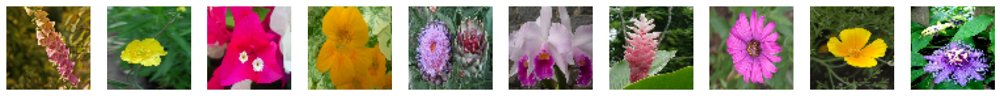

In [7]:
# 훈련 세트에 있는 몇 개의 꽃 이미지를 출력합니다.
train_sample = sample_batch(train)
display(train_sample)

### 1.1 확산 스케줄

In [8]:
def linear_diffusion_schedule(diffusion_times):
    min_rate = 0.0001 # 확산과정의 각 단계에서 이미지에 추가되는 노이즈의 양을 결정합니다.
    max_rate = 0.02
    betas = min_rate + diffusion_times * (max_rate - min_rate)
    alphas = 1 - betas
    alpha_bars = tf.math.cumprod(alphas)
    signal_rates = tf.sqrt(alpha_bars)
    noise_rates = tf.sqrt(1 - alpha_bars)
    return noise_rates, signal_rates

In [9]:
def cosine_diffusion_schedule(diffusion_times):
    signal_rates = tf.cos(diffusion_times * math.pi / 2) # 코사인 함수를 이용하여 각 시간단계에서 신호비율을 계산합니다.
    noise_rates = tf.sin(diffusion_times * math.pi / 2) # 사인함수를 사용하여 각 시간 단계에서의 노이즈 비율을 계산합니다.
    return noise_rates, signal_rates

In [10]:
def offset_cosine_diffusion_schedule(diffusion_times):
    min_signal_rate = 0.02 # 확산과정에서 신호 비율이 가질수있는 최대 최소값을 설저합니다.
    max_signal_rate = 0.95
    start_angle = tf.acos(max_signal_rate) # 코사인의 역함수를 사용하여 최대 신호 비율에 해당하는 시작 각도를 계산합니다.
    end_angle = tf.acos(min_signal_rate)

    diffusion_angles = start_angle + diffusion_times * (end_angle - start_angle) # 각 시간단계에 해당하는 확산 각도를 계산합니다.

    signal_rates = tf.cos(diffusion_angles)
    noise_rates = tf.sin(diffusion_angles)

    return noise_rates, signal_rates

In [11]:
T = 1000 # 확산 프로세스의 총 단계수 입니다.
diffusion_times = tf.convert_to_tensor([x / T for x in range(T)])
linear_noise_rates, linear_signal_rates = linear_diffusion_schedule(
    diffusion_times
)
cosine_noise_rates, cosine_signal_rates = cosine_diffusion_schedule(
    diffusion_times
)
(
    offset_cosine_noise_rates,
    offset_cosine_signal_rates,
) = offset_cosine_diffusion_schedule(diffusion_times) # 확산 기반 생성 모델에서 이미지에 노이즈를 추가하고 제거하는 과정을 다양한 방식으로 제어할 수 있는 방법을 제공합니다.

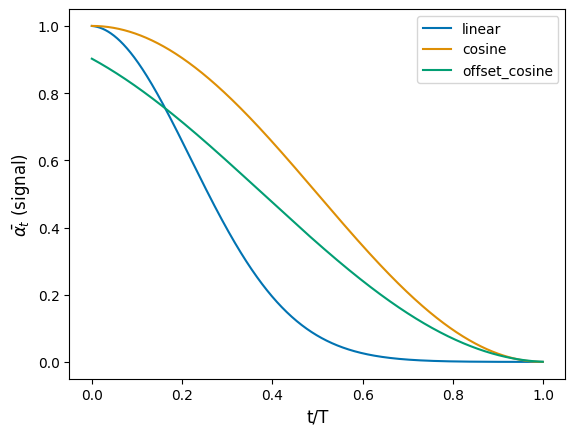

In [12]:
plt.plot(
    diffusion_times, linear_signal_rates**2, linewidth=1.5, label="linear"
)
plt.plot(
    diffusion_times, cosine_signal_rates**2, linewidth=1.5, label="cosine"
)
plt.plot(
    diffusion_times,
    offset_cosine_signal_rates**2,
    linewidth=1.5,
    label="offset_cosine",
)

plt.xlabel("t/T", fontsize=12)
plt.ylabel(r"$\bar{\alpha_t}$ (signal)", fontsize=12)
plt.legend()
plt.show() # 확산 모델에서 사용되는 서로다른 확산일정이 시가에 따라 어떻게 변화하는지를 시각적으로 비교할수있습니다.

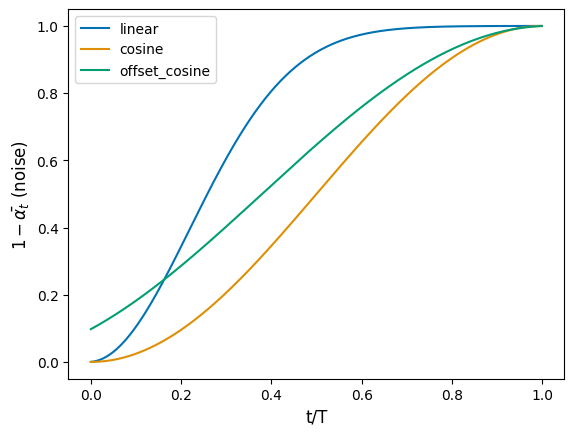

In [13]:
plt.plot(
    diffusion_times, linear_noise_rates**2, linewidth=1.5, label="linear"
)
plt.plot(
    diffusion_times, cosine_noise_rates**2, linewidth=1.5, label="cosine"
)
plt.plot(
    diffusion_times,
    offset_cosine_noise_rates**2,
    linewidth=1.5,
    label="offset_cosine",
)

plt.xlabel("t/T", fontsize=12)
plt.ylabel(r"$1-\bar{\alpha_t}$ (noise)", fontsize=12)
plt.legend()
plt.show() # 노이즈비율의 제곱을 시각화하는 과정을 보여줍니다.(확산 일정에 따라 노이즈 비율이 어떻게 변화하는지를 이해하는데 도움이됩니다.)

# 2. 모델 구축

In [14]:
def sinusoidal_embedding(x):
    frequencies = tf.exp(
        tf.linspace(
            tf.math.log(1.0),
            tf.math.log(1000.0),
            NOISE_EMBEDDING_SIZE // 2,
        )
    )
    angular_speeds = 2.0 * math.pi * frequencies
    embeddings = tf.concat(
        [tf.sin(angular_speeds * x), tf.cos(angular_speeds * x)], axis=3
    )
    return embeddings # 사인파 임베딩을 생성하는 함수입니다.(사인파 임베딩은 주어진 입력값에 대해 다양한 주파수의 사인 및 코사인 값을 계산하여 특성을 확장하는 방법입니다.)

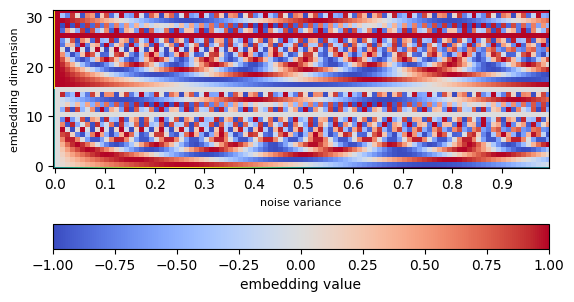

In [15]:
embedding_list = [] # 리스트를 생성합니다.
for y in np.arange(0, 1, 0.01): # 0부터 1까지 0.1간격으로 실행합니다.
    embedding_list.append(sinusoidal_embedding(np.array([[[[y]]]]))[0][0][0])
embedding_array = np.array(np.transpose(embedding_list)) # 함수를 호출하여 임베딩을 계산하여 임베딩 리스트에 추가합니다.
fig, ax = plt.subplots() # x축과 y축에 label을 추가합니다.
ax.set_xticks(
    np.arange(0, 100, 10), labels=np.round(np.arange(0.0, 1.0, 0.1), 1)
)
ax.set_ylabel("embedding dimension", fontsize=8)
ax.set_xlabel("noise variance", fontsize=8)
plt.pcolor(embedding_array, cmap="coolwarm") # 컬러맵으로 그립니다.
plt.colorbar(orientation="horizontal", label="embedding value") # 임베딩값의 스케일을 나타냅니다.
ax.imshow(embedding_array, interpolation="nearest", origin="lower")
plt.show() # 노이즈의 변화에 따라 사인파 임베딩이 어떻게 변화하는지 보여줍니다.

In [16]:
def ResidualBlock(width): # 잔차 블록을 구성하는 함수입니다.
    def apply(x):
        input_width = x.shape[3]
        if input_width == width:
            residual = x
        else:
            residual = layers.Conv2D(width, kernel_size=1)(x)
        x = layers.BatchNormalization(center=False, scale=False)(x)
        x = layers.Conv2D(
            width, kernel_size=3, padding="same", activation=activations.swish
        )(x)
        x = layers.Conv2D(width, kernel_size=3, padding="same")(x)
        x = layers.Add()([x, residual])
        return x

    return apply


def DownBlock(width, block_depth): # 다운샘플링을 수행하는 블록을 구성합니다.
    def apply(x):
        x, skips = x
        for _ in range(block_depth):
            x = ResidualBlock(width)(x)
            skips.append(x)
        x = layers.AveragePooling2D(pool_size=2)(x)
        return x

    return apply


def UpBlock(width, block_depth): # 업샘플링을 수행하는 블록을 구성합니다.
    def apply(x):
        x, skips = x
        x = layers.UpSampling2D(size=2, interpolation="bilinear")(x)
        for _ in range(block_depth):
            x = layers.Concatenate()([x, skips.pop()])
            x = ResidualBlock(width)(x)
        return x

    return apply
    # U-Net 네트워크에서 찾아볼 수 있는 패턴을 따르며, 이미지 세그멘테이션, 이미지 복원, 스타일 전이 등과 같은 작업에 사용됩니다.
    # 잔차블록, 다운샘플링 및 업샘플링은 깊은 네트워크에서 효율적인 정보 전달과 학습을 가능하게 합니다.

In [17]:
# U-Net 구축

noisy_images = layers.Input(shape=(IMAGE_SIZE, IMAGE_SIZE, 3))
x = layers.Conv2D(32, kernel_size=1)(noisy_images)

noise_variances = layers.Input(shape=(1, 1, 1))
noise_embedding = layers.Lambda(sinusoidal_embedding)(noise_variances)
noise_embedding = layers.UpSampling2D(size=IMAGE_SIZE, interpolation="nearest")(
    noise_embedding
)

x = layers.Concatenate()([x, noise_embedding])

skips = []

x = DownBlock(32, block_depth=2)([x, skips])
x = DownBlock(64, block_depth=2)([x, skips])
x = DownBlock(96, block_depth=2)([x, skips])

x = ResidualBlock(128)(x)
x = ResidualBlock(128)(x)

x = UpBlock(96, block_depth=2)([x, skips])
x = UpBlock(64, block_depth=2)([x, skips])
x = UpBlock(32, block_depth=2)([x, skips])

x = layers.Conv2D(3, kernel_size=1, kernel_initializer="zeros")(x)

unet = models.Model([noisy_images, noise_variances], x, name="unet")

In [18]:
class DiffusionModel(models.Model): # TensorFlow를 사용하여 확산모델(Diffusion Model)을 구현한 클래스 입니다.
    def __init__(self): # 모델의 구조를 정의합니다.
        super().__init__()

        self.normalizer = layers.Normalization()
        self.network = unet
        self.ema_network = models.clone_model(self.network)
        self.diffusion_schedule = offset_cosine_diffusion_schedule

    def compile(self, **kwargs): # 모델을 컴파일하는 데 필요한 설정들을 정의합니다.
        super().compile(**kwargs)
        self.noise_loss_tracker = metrics.Mean(name="n_loss")

    @property
    def metrics(self):
        return [self.noise_loss_tracker]

    def denormalize(self, images):
        images = self.normalizer.mean + images * self.normalizer.variance**0.5
        return tf.clip_by_value(images, 0.0, 1.0)

    def denoise(self, noisy_images, noise_rates, signal_rates, training): # 노이즈 제거 함수를 추가합니다.
        if training:
            network = self.network
        else:
            network = self.ema_network
        pred_noises = network(
            [noisy_images, noise_rates**2], training=training
        )
        pred_images = (noisy_images - noise_rates * pred_noises) / signal_rates

        return pred_noises, pred_images

    def reverse_diffusion(self, initial_noise, diffusion_steps): # 역확산 함수도 추가합니다.
        num_images = initial_noise.shape[0]
        step_size = 1.0 / diffusion_steps
        current_images = initial_noise
        for step in range(diffusion_steps):
            diffusion_times = tf.ones((num_images, 1, 1, 1)) - step * step_size
            noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
            pred_noises, pred_images = self.denoise(
                current_images, noise_rates, signal_rates, training=False
            )
            next_diffusion_times = diffusion_times - step_size
            next_noise_rates, next_signal_rates = self.diffusion_schedule(
                next_diffusion_times
            )
            current_images = (
                next_signal_rates * pred_images + next_noise_rates * pred_noises
            )
        return pred_images

    def generate(self, num_images, diffusion_steps, initial_noise=None):
        if initial_noise is None:
            initial_noise = tf.random.normal(
                shape=(num_images, IMAGE_SIZE, IMAGE_SIZE, 3)
            )
        generated_images = self.reverse_diffusion(
            initial_noise, diffusion_steps
        )
        generated_images = self.denormalize(generated_images)
        return generated_images

    def train_step(self, images):
        images = self.normalizer(images, training=True)
        noises = tf.random.normal(shape=(BATCH_SIZE, IMAGE_SIZE, IMAGE_SIZE, 3))

        diffusion_times = tf.random.uniform(
            shape=(BATCH_SIZE, 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)

        noisy_images = signal_rates * images + noise_rates * noises

        with tf.GradientTape() as tape:
            # 잡음 이미지에서 잡음을 구분하도록 훈련합니다.
            pred_noises, pred_images = self.denoise(
                noisy_images, noise_rates, signal_rates, training=True
            )

            noise_loss = self.loss(noises, pred_noises)  # 훈련에 사용

        gradients = tape.gradient(noise_loss, self.network.trainable_weights)
        self.optimizer.apply_gradients(
            zip(gradients, self.network.trainable_weights)
        )

        self.noise_loss_tracker.update_state(noise_loss)

        for weight, ema_weight in zip(
            self.network.weights, self.ema_network.weights
        ):
            ema_weight.assign(EMA * ema_weight + (1 - EMA) * weight)

        return {m.name: m.result() for m in self.metrics}

    def test_step(self, images):
        images = self.normalizer(images, training=False)
        noises = tf.random.normal(shape=(BATCH_SIZE, IMAGE_SIZE, IMAGE_SIZE, 3))
        diffusion_times = tf.random.uniform(
            shape=(BATCH_SIZE, 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
        noisy_images = signal_rates * images + noise_rates * noises
        pred_noises, pred_images = self.denoise(
            noisy_images, noise_rates, signal_rates, training=False
        )
        noise_loss = self.loss(noises, pred_noises)
        self.noise_loss_tracker.update_state(noise_loss)

        return {m.name: m.result() for m in self.metrics}

In [19]:
ddm = DiffusionModel() # 위에서 만든 DiffusionModel을 실행합니다.(클래스의 인스턴스를 생성합니다.)
ddm.normalizer.adapt(train)

In [20]:
if LOAD_MODEL:
    ddm.built = True
    ddm.load_weights("./checkpoint/checkpoint.ckpt") # 가중치를 로드하는 조건부 로직입니다.

# 3.모델 훈련

In [21]:
ddm.compile(
    optimizer=optimizers.experimental.AdamW( # 옵티마이저와 손실함수를 설정합니다.
        learning_rate=LEARNING_RATE, weight_decay=WEIGHT_DECAY
    ),
    loss=losses.mean_absolute_error,
) # 훈련시키기전 필요한 설정들을 합니다.

Epoch 1/50
  6/639 [..............................] - ETA: 1:59 - n_loss: 0.7822

639/639 [==============================] - ETA: 0s - n_loss: 0.2331
Saved to ./output/generated_img_000.png


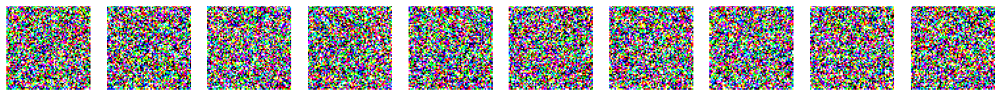

639/639 [==============================] - 160s 198ms/step - n_loss: 0.2331
Epoch 2/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1951
Saved to ./output/generated_img_001.png


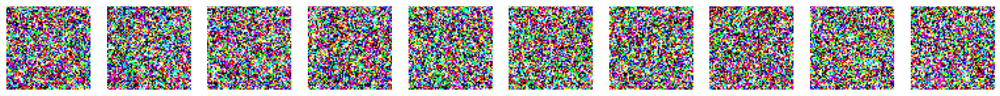

639/639 [==============================] - 140s 217ms/step - n_loss: 0.1951
Epoch 3/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1889
Saved to ./output/generated_img_002.png


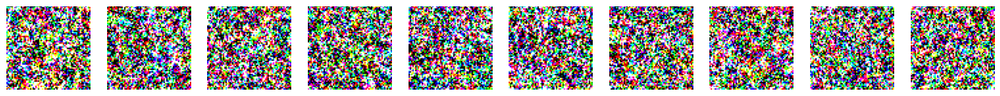

639/639 [==============================] - 134s 207ms/step - n_loss: 0.1889
Epoch 4/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1852
Saved to ./output/generated_img_003.png


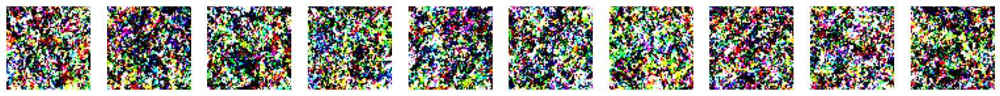

639/639 [==============================] - 136s 211ms/step - n_loss: 0.1852
Epoch 5/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1830
Saved to ./output/generated_img_004.png


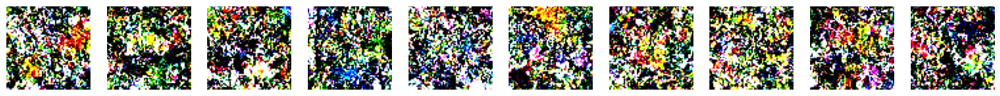

639/639 [==============================] - 136s 210ms/step - n_loss: 0.1830
Epoch 6/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1817
Saved to ./output/generated_img_005.png


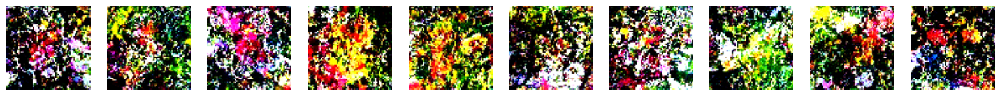

639/639 [==============================] - 140s 217ms/step - n_loss: 0.1817
Epoch 7/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1810
Saved to ./output/generated_img_006.png


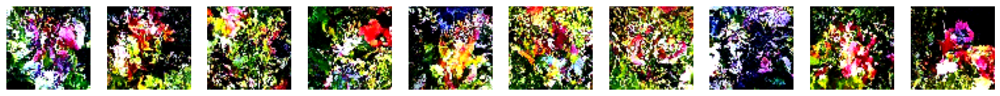

639/639 [==============================] - 140s 215ms/step - n_loss: 0.1810
Epoch 8/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1792
Saved to ./output/generated_img_007.png


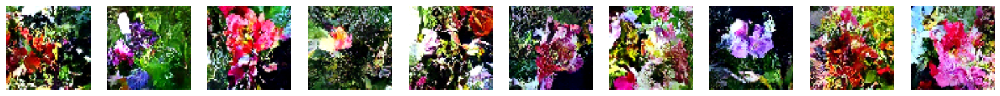

639/639 [==============================] - 144s 222ms/step - n_loss: 0.1792
Epoch 9/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1785
Saved to ./output/generated_img_008.png


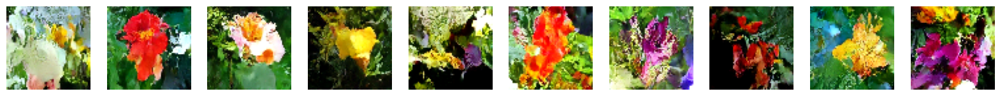

639/639 [==============================] - 142s 220ms/step - n_loss: 0.1785
Epoch 10/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1784
Saved to ./output/generated_img_009.png


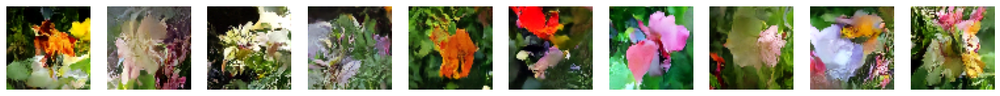

639/639 [==============================] - 137s 212ms/step - n_loss: 0.1784
Epoch 11/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1782
Saved to ./output/generated_img_010.png


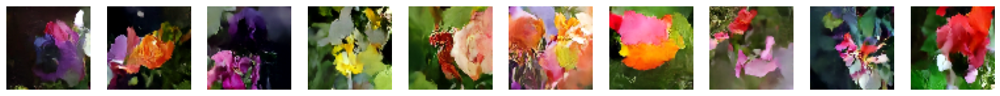

639/639 [==============================] - 136s 211ms/step - n_loss: 0.1782
Epoch 12/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1766
Saved to ./output/generated_img_011.png


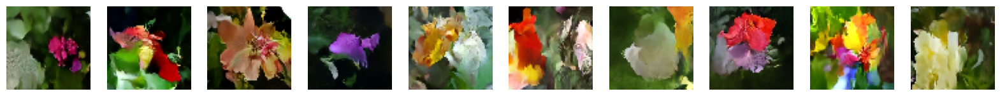

639/639 [==============================] - 138s 213ms/step - n_loss: 0.1766
Epoch 13/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1763
Saved to ./output/generated_img_012.png


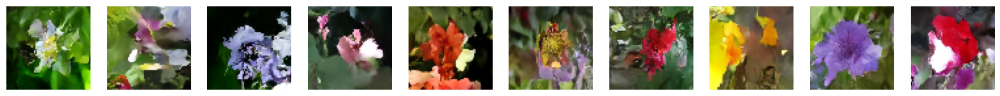

639/639 [==============================] - 135s 210ms/step - n_loss: 0.1763
Epoch 14/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1756
Saved to ./output/generated_img_013.png


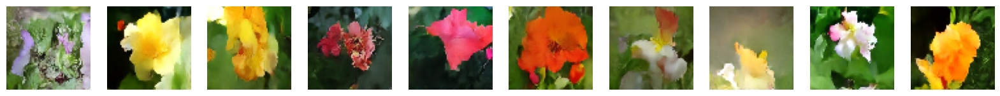

639/639 [==============================] - 137s 212ms/step - n_loss: 0.1756
Epoch 15/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1754
Saved to ./output/generated_img_014.png


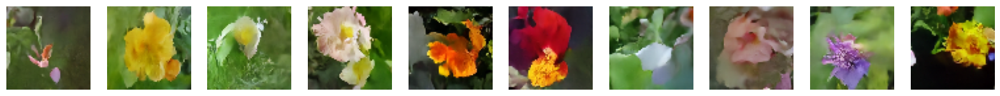

639/639 [==============================] - 137s 212ms/step - n_loss: 0.1754
Epoch 16/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1760
Saved to ./output/generated_img_015.png


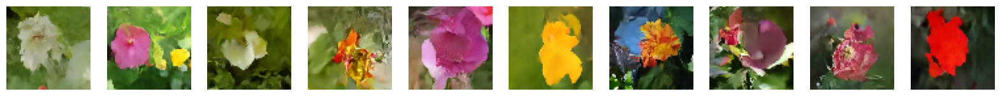

639/639 [==============================] - 137s 213ms/step - n_loss: 0.1760
Epoch 17/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1765
Saved to ./output/generated_img_016.png


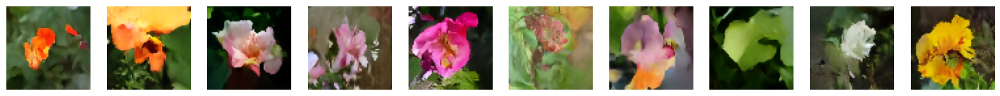

639/639 [==============================] - 138s 213ms/step - n_loss: 0.1765
Epoch 18/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1746
Saved to ./output/generated_img_017.png


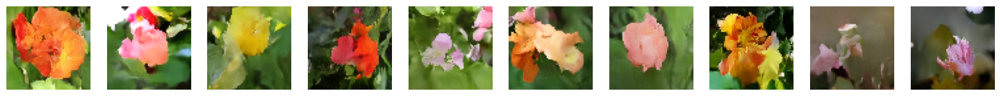

639/639 [==============================] - 137s 212ms/step - n_loss: 0.1746
Epoch 19/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1749
Saved to ./output/generated_img_018.png


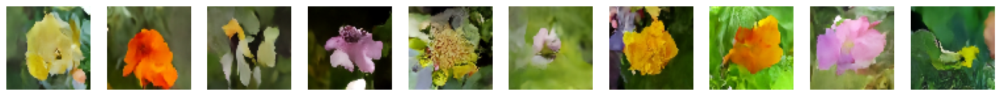

639/639 [==============================] - 138s 213ms/step - n_loss: 0.1749
Epoch 20/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1749
Saved to ./output/generated_img_019.png


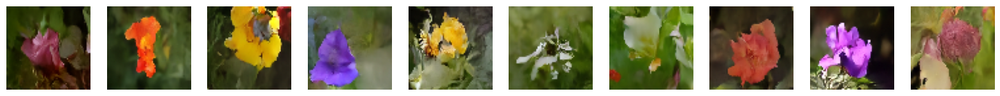

639/639 [==============================] - 138s 214ms/step - n_loss: 0.1749
Epoch 21/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1743
Saved to ./output/generated_img_020.png


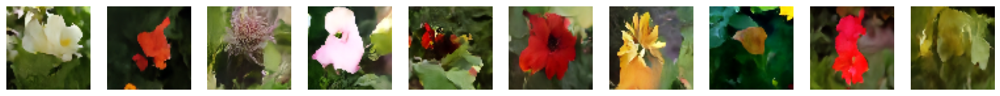

639/639 [==============================] - 138s 214ms/step - n_loss: 0.1743
Epoch 22/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1739
Saved to ./output/generated_img_021.png


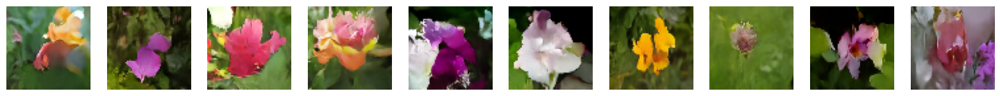

639/639 [==============================] - 138s 214ms/step - n_loss: 0.1739
Epoch 23/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1744
Saved to ./output/generated_img_022.png


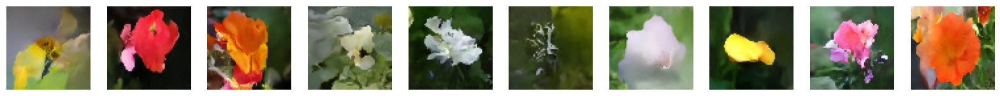

639/639 [==============================] - 139s 215ms/step - n_loss: 0.1744
Epoch 24/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1735
Saved to ./output/generated_img_023.png


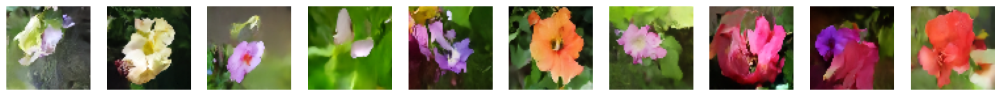

639/639 [==============================] - 139s 215ms/step - n_loss: 0.1735
Epoch 25/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1740
Saved to ./output/generated_img_024.png


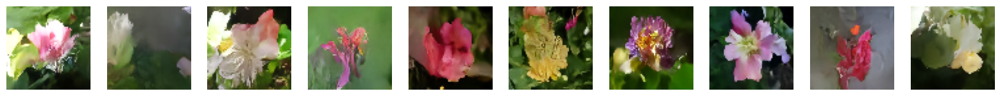

639/639 [==============================] - 138s 214ms/step - n_loss: 0.1740
Epoch 26/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1741
Saved to ./output/generated_img_025.png


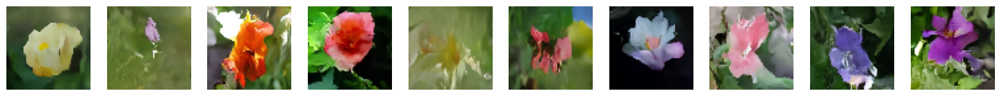

639/639 [==============================] - 141s 217ms/step - n_loss: 0.1741
Epoch 27/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1730
Saved to ./output/generated_img_026.png


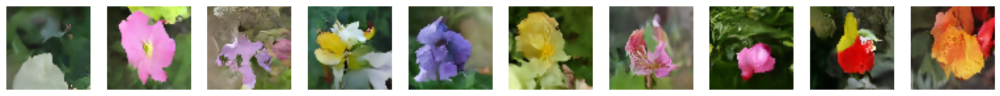

639/639 [==============================] - 140s 216ms/step - n_loss: 0.1730
Epoch 28/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1731
Saved to ./output/generated_img_027.png


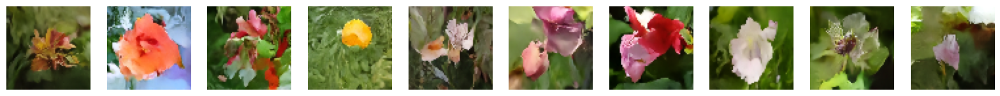

639/639 [==============================] - 141s 218ms/step - n_loss: 0.1731
Epoch 29/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1737
Saved to ./output/generated_img_028.png


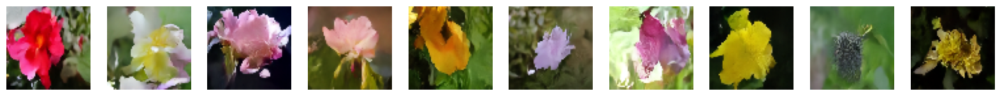

639/639 [==============================] - 142s 220ms/step - n_loss: 0.1737
Epoch 30/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1734
Saved to ./output/generated_img_029.png


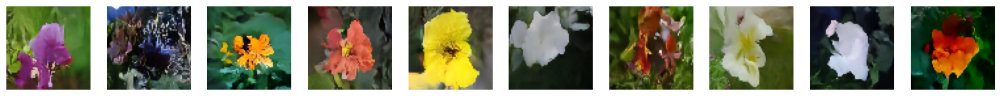

639/639 [==============================] - 142s 221ms/step - n_loss: 0.1734
Epoch 31/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1731
Saved to ./output/generated_img_030.png


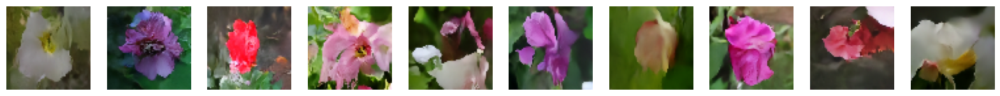

639/639 [==============================] - 144s 223ms/step - n_loss: 0.1731
Epoch 32/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1728
Saved to ./output/generated_img_031.png


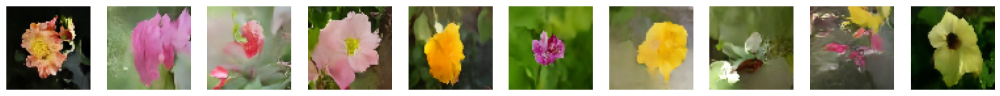

639/639 [==============================] - 144s 224ms/step - n_loss: 0.1728
Epoch 33/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1726
Saved to ./output/generated_img_032.png


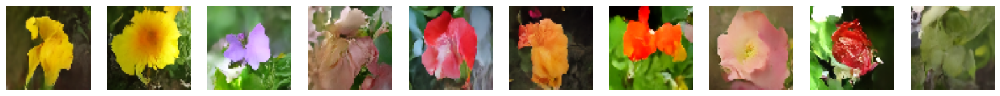

639/639 [==============================] - 144s 221ms/step - n_loss: 0.1726
Epoch 34/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1727
Saved to ./output/generated_img_033.png


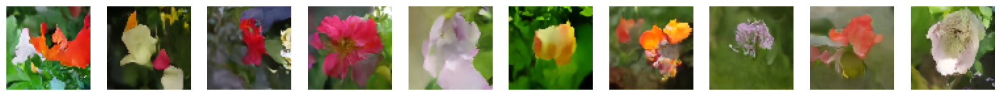

639/639 [==============================] - 152s 234ms/step - n_loss: 0.1727
Epoch 35/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1732
Saved to ./output/generated_img_034.png


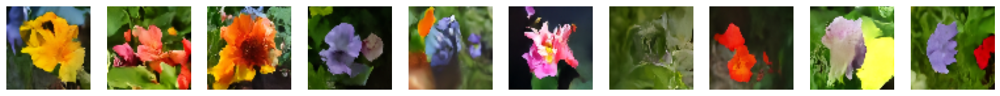

639/639 [==============================] - 143s 220ms/step - n_loss: 0.1732
Epoch 36/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1733
Saved to ./output/generated_img_035.png


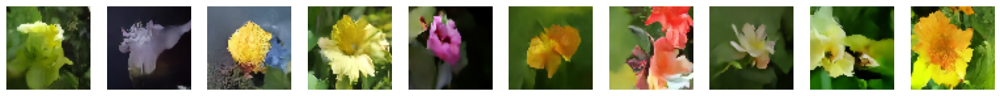

639/639 [==============================] - 163s 252ms/step - n_loss: 0.1733
Epoch 37/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1716
Saved to ./output/generated_img_036.png


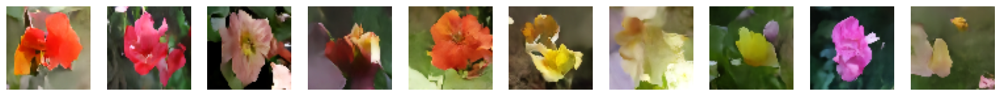

639/639 [==============================] - 156s 242ms/step - n_loss: 0.1716
Epoch 38/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1723
Saved to ./output/generated_img_037.png


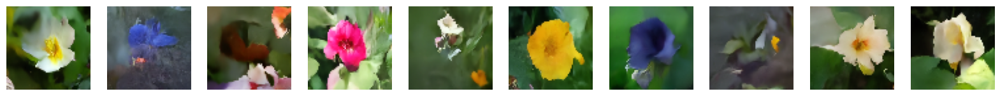

639/639 [==============================] - 152s 235ms/step - n_loss: 0.1723
Epoch 39/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1720
Saved to ./output/generated_img_038.png


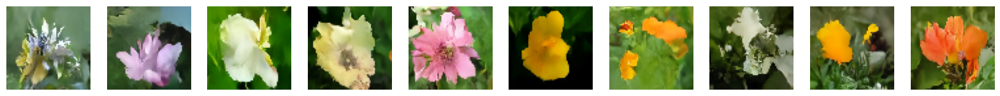

639/639 [==============================] - 143s 222ms/step - n_loss: 0.1720
Epoch 40/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1723
Saved to ./output/generated_img_039.png


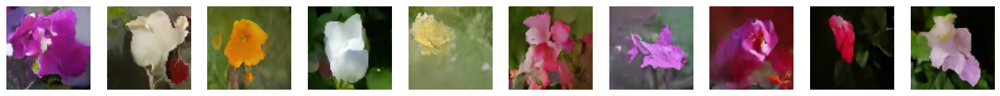

639/639 [==============================] - 143s 223ms/step - n_loss: 0.1723
Epoch 41/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1730
Saved to ./output/generated_img_040.png


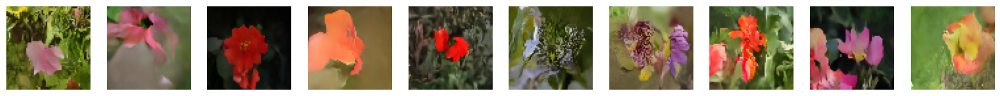

639/639 [==============================] - 146s 227ms/step - n_loss: 0.1730
Epoch 42/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1718
Saved to ./output/generated_img_041.png


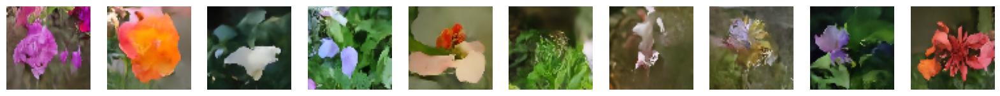

639/639 [==============================] - 160s 247ms/step - n_loss: 0.1718
Epoch 43/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1718
Saved to ./output/generated_img_042.png


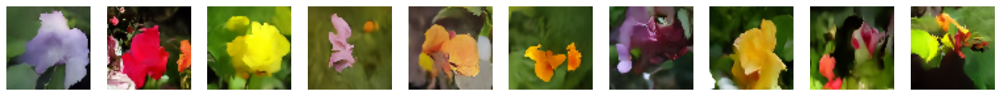

639/639 [==============================] - 159s 244ms/step - n_loss: 0.1718
Epoch 44/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1719
Saved to ./output/generated_img_043.png


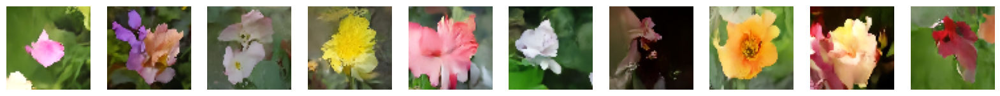

639/639 [==============================] - 146s 225ms/step - n_loss: 0.1719
Epoch 45/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1715
Saved to ./output/generated_img_044.png


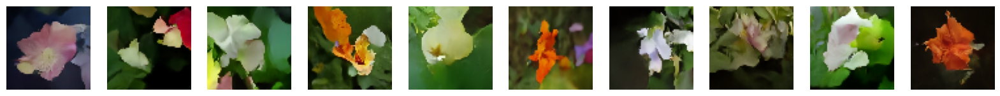

639/639 [==============================] - 144s 224ms/step - n_loss: 0.1715
Epoch 46/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1719
Saved to ./output/generated_img_045.png


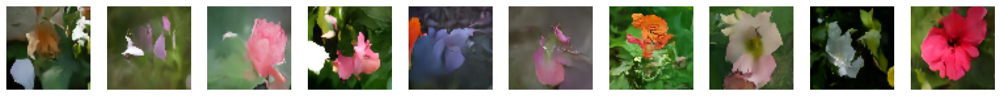

639/639 [==============================] - 144s 224ms/step - n_loss: 0.1719
Epoch 47/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1716
Saved to ./output/generated_img_046.png


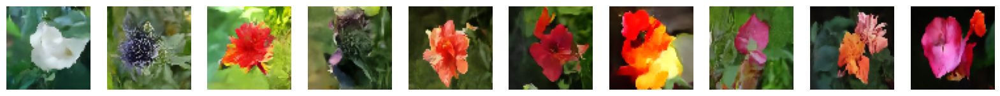

639/639 [==============================] - 146s 225ms/step - n_loss: 0.1716
Epoch 48/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1718
Saved to ./output/generated_img_047.png


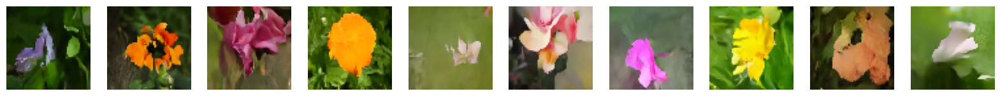

639/639 [==============================] - 147s 226ms/step - n_loss: 0.1718
Epoch 49/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1711
Saved to ./output/generated_img_048.png


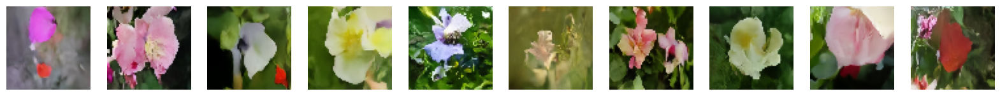

639/639 [==============================] - 144s 222ms/step - n_loss: 0.1711
Epoch 50/50
639/639 [==============================] - ETA: 0s - n_loss: 0.1709
Saved to ./output/generated_img_049.png


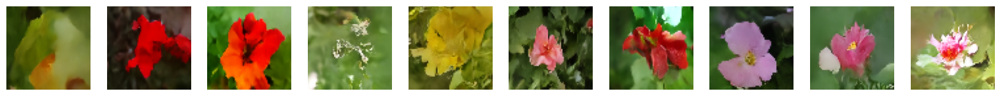

639/639 [==============================] - 146s 224ms/step - n_loss: 0.1709


In [22]:
# 훈련을 실행하고 생성된 이미지를 주기적으로 출력합니다.
model_checkpoint_callback = callbacks.ModelCheckpoint(
    filepath="./checkpoint/checkpoint.ckpt",
    save_weights_only=True,
    save_freq="epoch",
    verbose=0,
)

tensorboard_callback = callbacks.TensorBoard(log_dir="./logs")


class ImageGenerator(callbacks.Callback):
    def __init__(self, num_img):
        self.num_img = num_img

    def on_epoch_end(self, epoch, logs=None):
        generated_images = self.model.generate(
            num_images=self.num_img,
            diffusion_steps=PLOT_DIFFUSION_STEPS,
        ).numpy()
        display(
            generated_images,
            save_to="./output/generated_img_%03d.png" % (epoch), # 훈련과정에서 생성된 이미지를 주기적으로 저장합니다.
        )


image_generator_callback = ImageGenerator(num_img=10)

ddm.fit(
    train,
    epochs=EPOCHS,
    callbacks=[
        model_checkpoint_callback,
        tensorboard_callback,
        image_generator_callback,
    ],
)

# 4. 추론

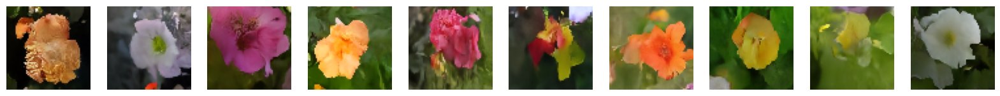

In [23]:
# 새로운 꽃 이미지 생성
generated_images = ddm.generate(num_images=10, diffusion_steps=20).numpy()
display(generated_images)

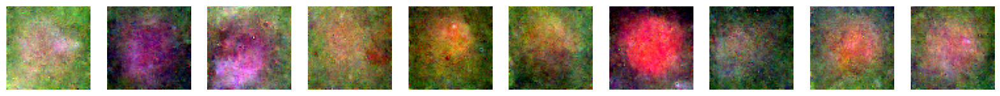

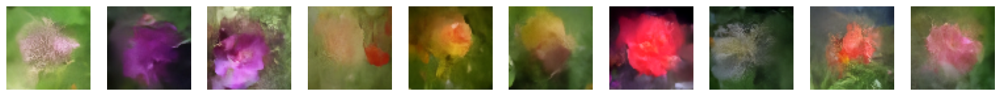

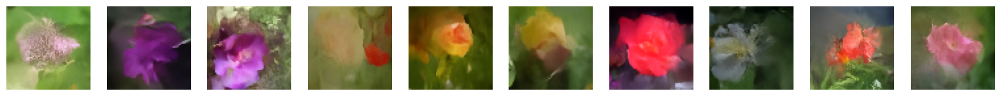

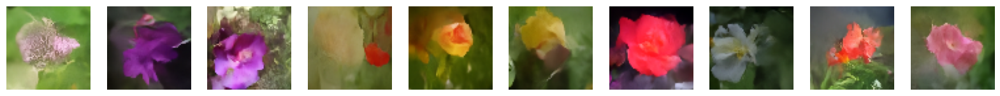

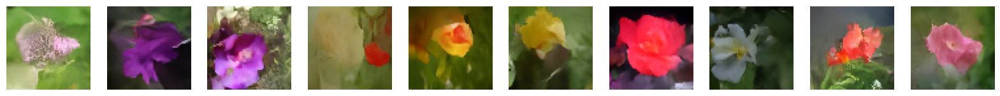

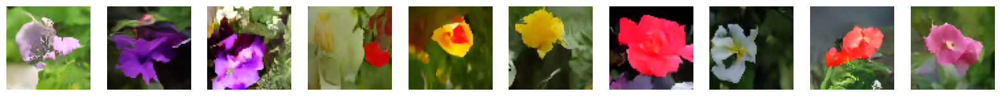

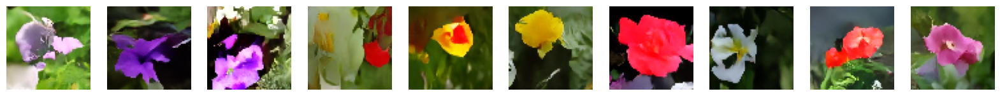

In [24]:
# 확산 단계 증가에 따른 이미지 품질 향상 확인
for diffusion_steps in list(np.arange(1, 6, 1)) + [20] + [100]:
    tf.random.set_seed(42)
    generated_images = ddm.generate(
        num_images=10,
        diffusion_steps=diffusion_steps,
    ).numpy()
    display(generated_images)

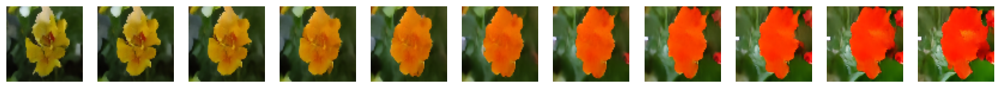

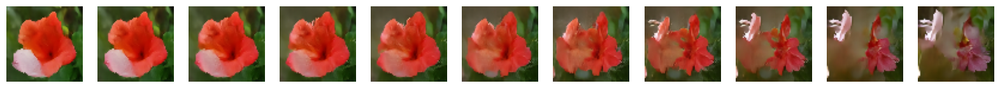

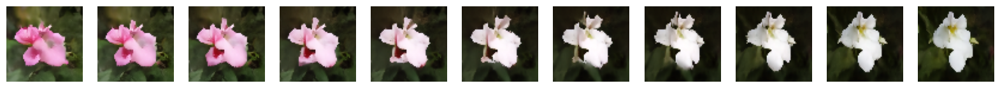

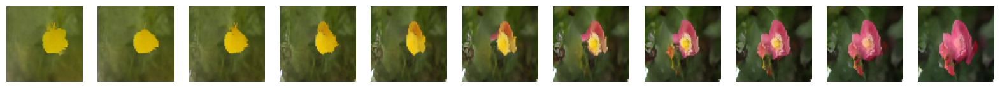

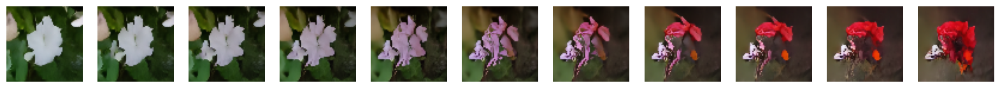

In [25]:
# 잡음 공간에 있는 두 포인트 사이를 보간
tf.random.set_seed(100)


def spherical_interpolation(a, b, t): # 두 잡음벡터 a와 b를 생성합니다.
    return np.sin(t * math.pi / 2) * a + np.cos(t * math.pi / 2) * b


for i in range(5): # 보간된 noise로 이미지를 생성합니다.
    a = tf.random.normal(shape=(IMAGE_SIZE, IMAGE_SIZE, 3))
    b = tf.random.normal(shape=(IMAGE_SIZE, IMAGE_SIZE, 3))
    initial_noise = np.array(
        [spherical_interpolation(a, b, t) for t in np.arange(0, 1.1, 0.1)]
    )
    generated_images = ddm.generate(
        num_images=2, diffusion_steps=20, initial_noise=initial_noise
    ).numpy()
    display(generated_images, n=11) # 생성된 이미지를 11개 나타냅니다.